# 🖼️ Analyse des masques de segmentation et adaptation de la palette de couleurs

## Objectifs de ce notebook

Dans ce notebook, nous allons :

- Identifier précisément **quelles classes** (labels uniques) sont présentes dans chacun des masques de segmentation du dataset.
- Déterminer **le nombre total de labels** différents utilisés sur l’ensemble des masques, afin de garantir que chaque type de vêtement ou accessoire pourra être clairement visualisé.
- Construire ou adapter une palette de couleurs qui **associe une couleur vive et distincte à chaque classe** réellement rencontrée dans les annotations et/ou prédictions.
- Préparer le terrain pour des visualisations lisibles (superposition images/masques, comparaison prédiction vs annotation, etc.) et pour les métriques de comparaison à venir.

## Pourquoi cette étape est-elle cruciale ?

- Les masques d’annotation multi-classes utilisent des entiers pour différencier chaque type de vêtement ou d’accessoire, mais ceux-ci ne sont pas toujours identiques à la palette standard proposée par le modèle ou la documentation.
- Une palette de couleurs incomplète empêche la lecture correcte des résultats : des classes peuvent être invisibles, fusionnées, ou mal identifiées lors de la présentation ou de l’analyse.
- En recensant les labels présents et en adaptant la palette, on s’assure que **chaque pièce annotée ou prédite sera représentée par une couleur unique**, offrant une visualisation parfaitement exploitable et professionnelle.

## Organisation du notebook

1. **Analyse automatique des masques** : Inventaire des labels présents dans chacun d’eux, et rapport global des valeurs utilisées dans tout le dataset.
2. **Conception/ajustement de la palette** : Génération d’une palette adaptée au nombre maximum de classes, compatible annotation et prédiction.
3. **Validation** : Test visuel (colorisation de masques) pour s’assurer qu’aucune classe ne manque à l’affichage.
4. **Préparation à l’évaluation quantitative** : Cette base garantira la solidité des métriques et des grilles de comparaison à venir.

In [2]:
# 📊 Analyse des labels uniques dans tous les masques d'annotation

import os
import numpy as np
from PIL import Image
from pathlib import Path

# Chemin vers le dossier de masques (à exécuter depuis /notebooks/)
mask_dir = Path('..') / 'data' / 'raw' / 'annotations'

# Liste des fichiers images (prend en compte png, jpg, jpeg)
mask_files = sorted([f for f in mask_dir.iterdir() if f.suffix.lower() in ['.png', '.jpg', '.jpeg']])

print(f"Analyse de {len(mask_files)} masques présents dans {mask_dir.resolve()}")

results = []
for f in mask_files:
    arr = np.array(Image.open(f))
    unique_labels = np.unique(arr)
    results.append((f.name, unique_labels.tolist(), len(unique_labels)))
    print(f"{f.name} : {len(unique_labels)} labels uniques - Labels = {unique_labels.tolist()}")

# Ensemble global de labels utilisés dans tous les masques
all_labels = sorted(set(l for _, labels, _ in results for l in labels))
print(f"\nNombre total de labels uniques dans tous les masques : {len(all_labels)}")
print(f"Liste des labels uniques totaux : {all_labels}")

Analyse de 50 masques présents dans /Users/daminou/Documents/Formation_IA/Projet_2/fashion-trend-intelligence/data/raw/annotations
mask_0.png : 11 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 12, 13, 15, 16]
mask_1.png : 10 labels uniques - Labels = [0, 1, 2, 4, 5, 6, 9, 10, 11, 16]
mask_10.png : 13 labels uniques - Labels = [0, 2, 4, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16]
mask_11.png : 11 labels uniques - Labels = [0, 1, 2, 4, 5, 9, 10, 11, 12, 13, 15]
mask_12.png : 11 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 12, 13, 14, 15]
mask_13.png : 12 labels uniques - Labels = [0, 2, 4, 5, 6, 8, 9, 10, 11, 14, 15, 16]
mask_14.png : 13 labels uniques - Labels = [0, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15]
mask_15.png : 10 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 13, 15, 16]
mask_16.png : 11 labels uniques - Labels = [0, 2, 7, 9, 10, 11, 12, 13, 14, 15, 16]
mask_17.png : 12 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 12, 13, 14, 15, 16]
mask_18.png : 10 labels uniques 

## ✅ Conclusion sur l’analyse des labels et choix de la palette

L’analyse des 50 masques d’annotation a révélé la présence de **18 labels uniques** (valeurs de 0 à 17) couvrant l’ensemble des classes annotées du dataset.  
Chaque masque individuel combine 8 à 14 classes selon l’image, mais **aucune valeur hors du standard n’a été détectée**. La colorisation peut donc s’appuyer pleinement sur la palette officielle du modèle SegFormer entraîné sur ATR.

---

### 🎨 Palette officielle SegFormer ATR (18 classes)

| Index | Classe            | Couleur RGB       |
|-------|-------------------|-------------------|
| 0     | Background        | [0, 0, 0]         |
| 1     | Hat               | [128, 0, 0]       |
| 2     | Hair              | [255, 0, 0]       |
| 3     | Sunglasses        | [0, 85, 0]        |
| 4     | Upper-clothes     | [170, 0, 51]      |
| 5     | Skirt             | [255, 85, 0]      |
| 6     | Pants             | [0, 0, 85]        |
| 7     | Dress             | [0, 119, 221]     |
| 8     | Belt              | [85, 85, 0]       |
| 9     | Left-shoe         | [0, 85, 85]       |
| 10    | Right-shoe        | [85, 51, 0]       |
| 11    | Face              | [52, 86, 128]     |
| 12    | Left-leg          | [0, 128, 0]       |
| 13    | Right-leg         | [0, 0, 255]       |
| 14    | Left-arm          | [51, 170, 221]    |
| 15    | Right-arm         | [0, 255, 255]     |
| 16    | Bag               | [85, 255, 170]    |
| 17    | Scarf             | [170, 255, 85]    |

---

- **Chaque valeur de label doit être associée à une couleur unique et bien distincte pour la lisibilité.**
- Cette palette garantit une visualisation claire de tous les types de vêtements/accessoires rencontrés dans tes masques annotés.
- Elle est compatible à la fois avec les masques de ground-truth (annotation) et les masques prédits par le modèle SegFormer-clothes ATR.

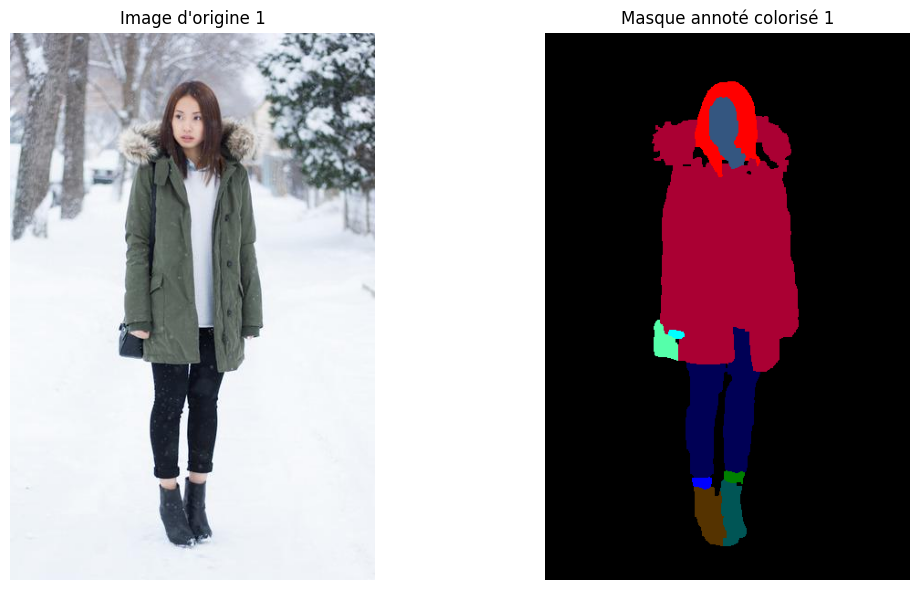

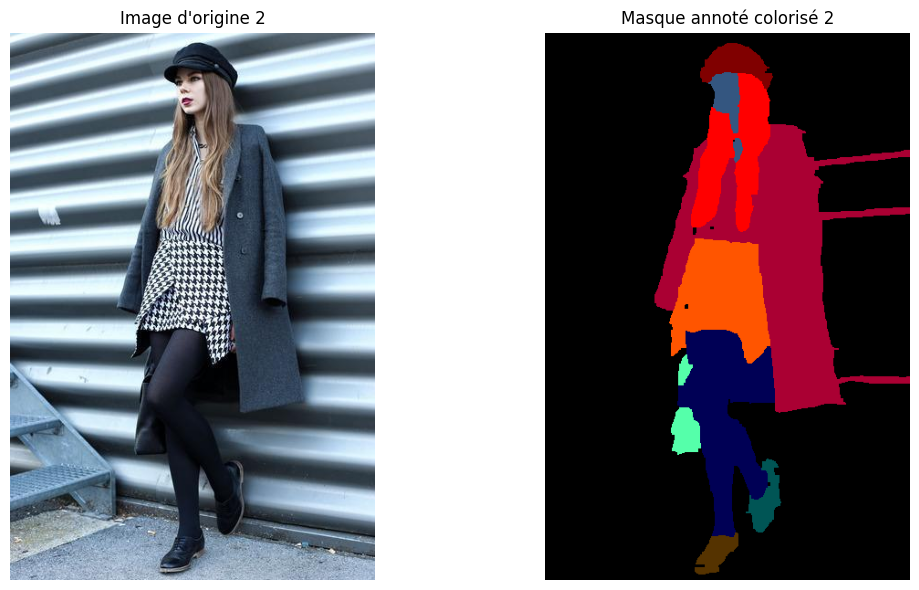

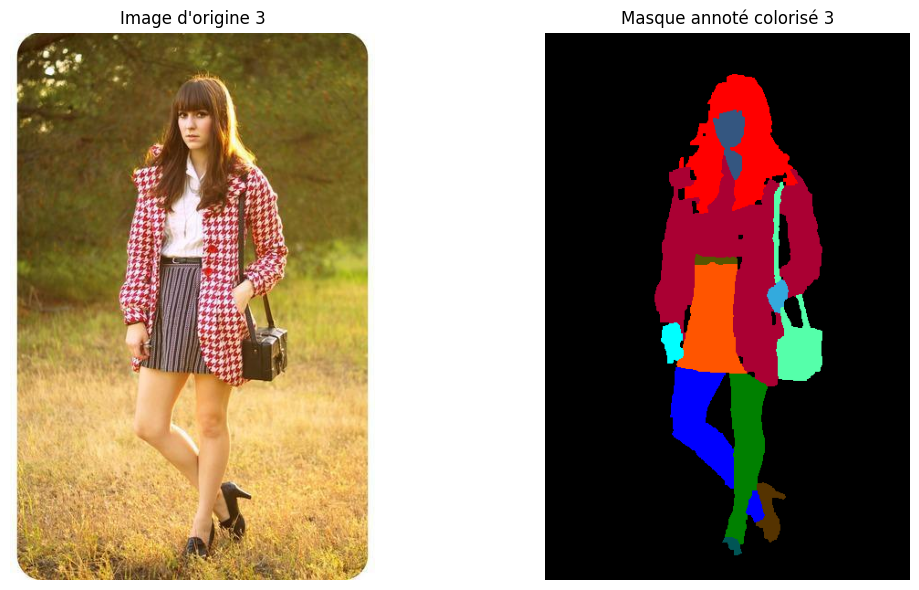

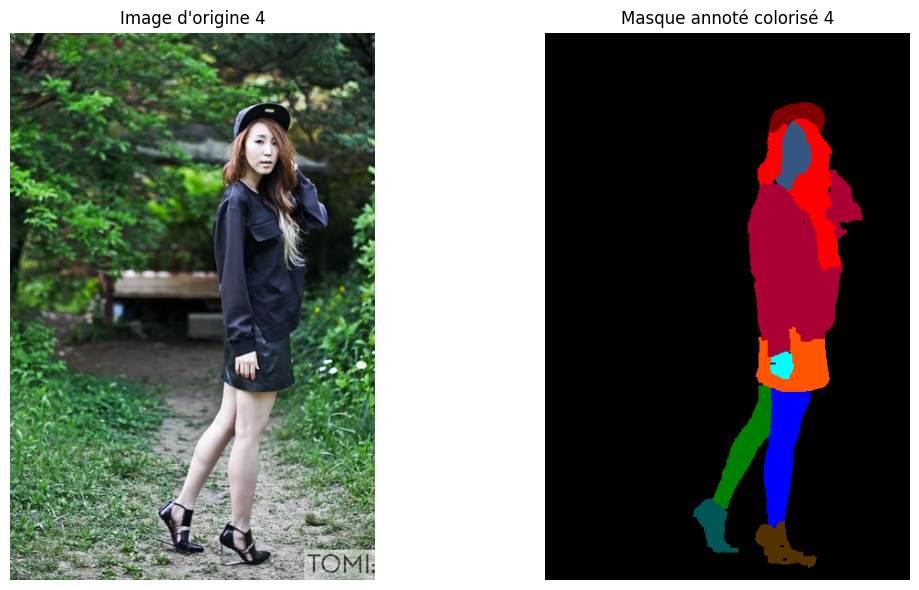

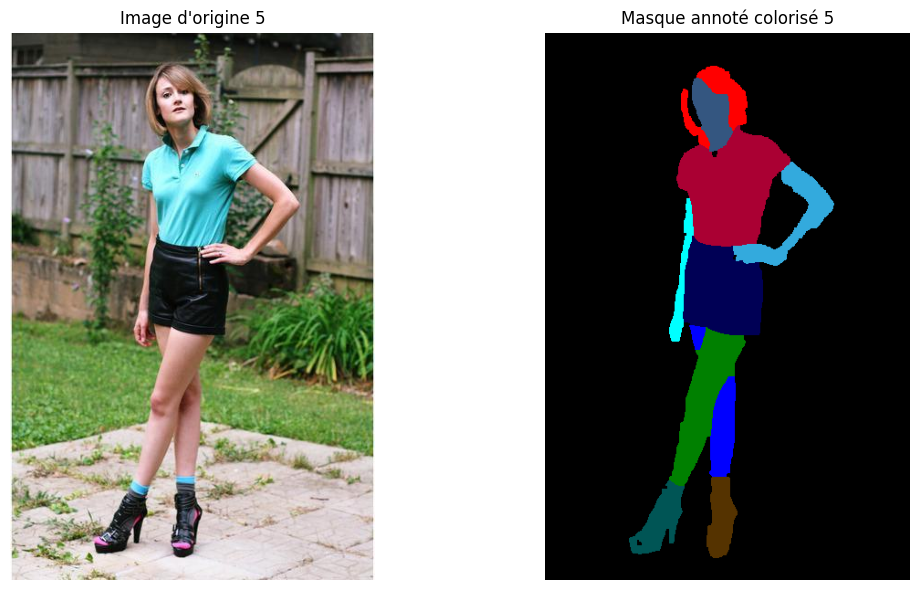

...

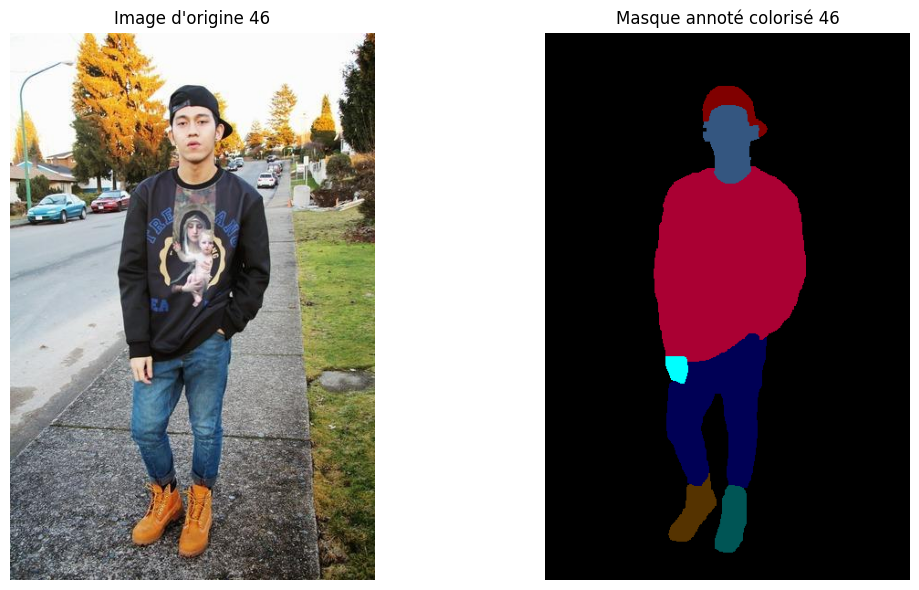

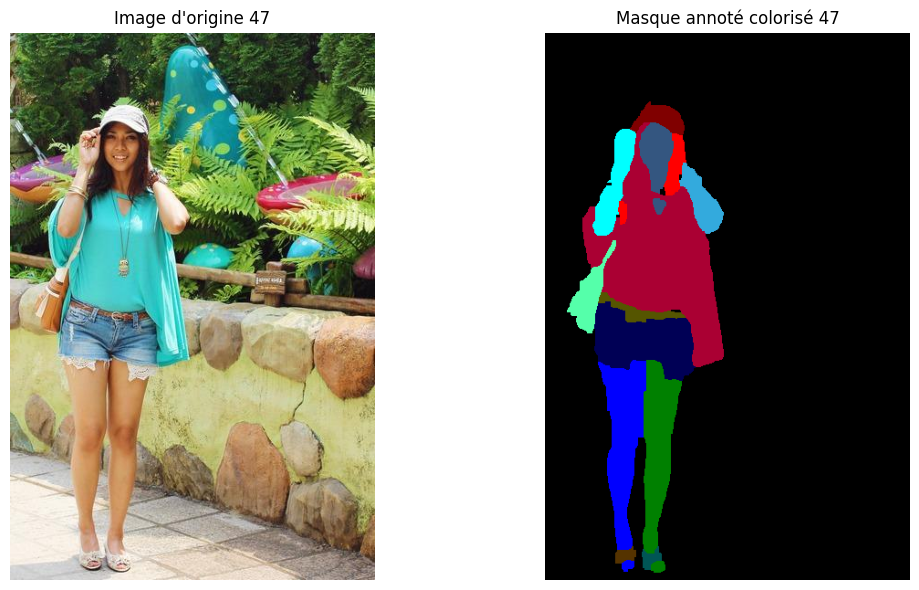

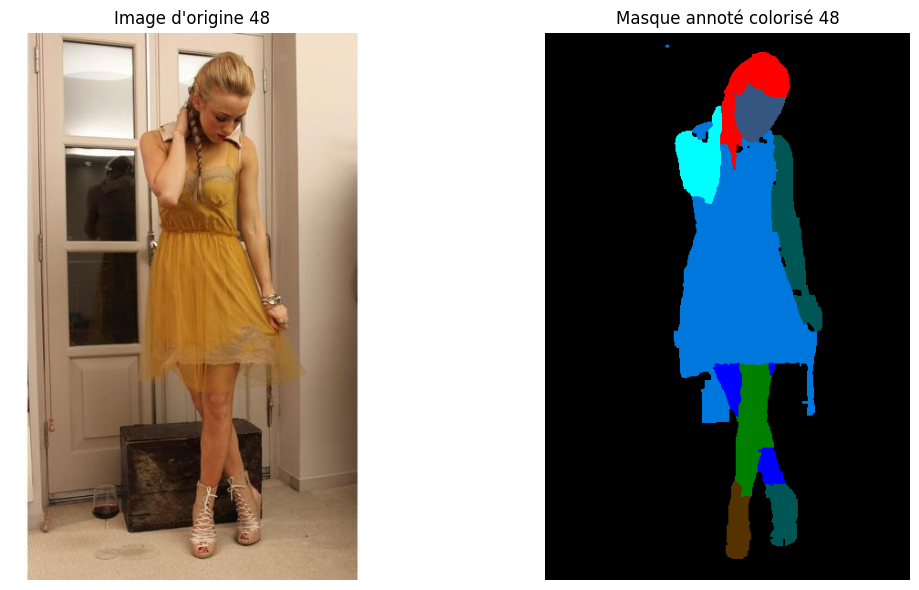

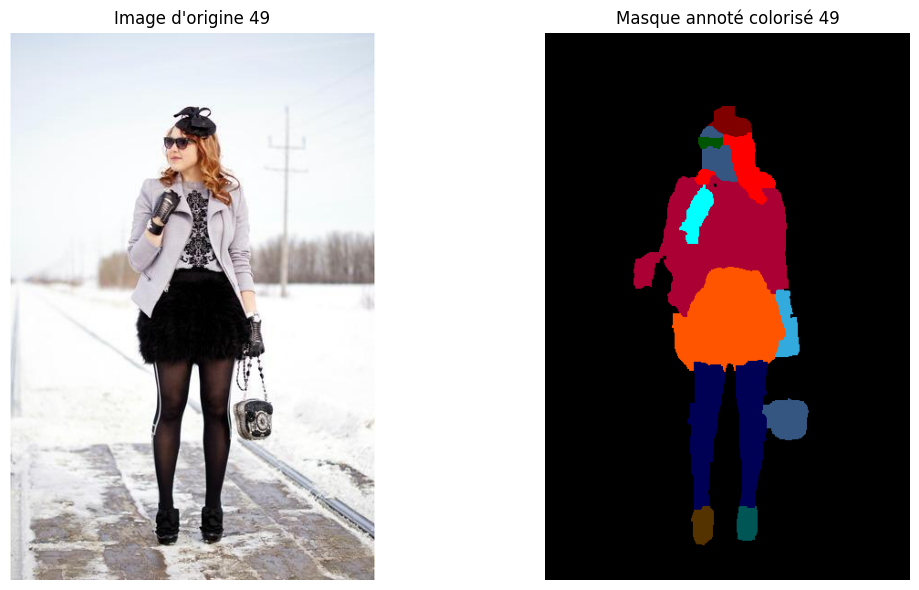

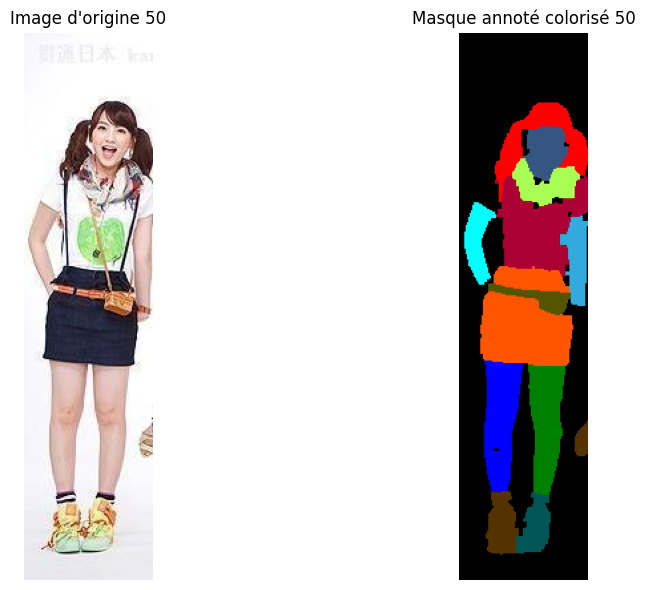

In [5]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from pathlib import Path

# Dossiers
img_dir = Path('..') / 'data' / 'raw' / 'images'
mask_annot_dir = Path('..') / 'data' / 'raw' / 'annotations'
output_dir = Path('..') / 'data' / 'processed' / 'masks_colorized'
output_dir.mkdir(parents=True, exist_ok=True)

# Palette officielle SegFormer ATR (18 classes)
palette = [
    [0, 0, 0],         # 0: Background
    [128, 0, 0],       # 1: Hat
    [255, 0, 0],       # 2: Hair
    [0, 85, 0],        # 3: Sunglasses
    [170, 0, 51],      # 4: Upper-clothes
    [255, 85, 0],      # 5: Skirt
    [0, 0, 85],        # 6: Pants
    [0, 119, 221],     # 7: Dress
    [85, 85, 0],       # 8: Belt
    [0, 85, 85],       # 9: Left-shoe
    [85, 51, 0],       # 10: Right-shoe
    [52, 86, 128],     # 11: Face
    [0, 128, 0],       # 12: Left-leg
    [0, 0, 255],       # 13: Right-leg
    [51, 170, 221],    # 14: Left-arm
    [0, 255, 255],     # 15: Right-arm
    [85, 255, 170],    # 16: Bag
    [170, 255, 85],    # 17: Scarf
]

def colorize_mask(mask):
    color_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)
    for label, color in enumerate(palette):
        color_mask[mask == label] = color
    return color_mask

# Récupérer les fichiers
img_files = sorted(img_dir.glob('*.png'))
annot_files = sorted(mask_annot_dir.glob('*.png'))

if img_files and annot_files:
    for idx, (img_path, annot_path) in enumerate(zip(img_files, annot_files)):
        # Ouvrir l'image et le masque
        img = np.array(Image.open(img_path))
        mask_annot = np.array(Image.open(annot_path))
        mask_annot_color = colorize_mask(mask_annot)
        
        # Sauvegarder le masque colorisé
        save_path = output_dir / f"{annot_path.stem}_colorized.png"
        Image.fromarray(mask_annot_color).save(save_path)
        
        # Afficher côte à côte
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))
        axs[0].imshow(img)
        axs[0].set_title(f"Image d'origine {idx+1}")
        axs[0].axis('off')
        axs[1].imshow(mask_annot_color)
        axs[1].set_title(f"Masque annoté colorisé {idx+1}")
        axs[1].axis('off')
        plt.tight_layout()
        plt.show()
else:
    print("Aucune image ou masque annoté trouvé dans les dossiers spécifiés.")


## ℹ️ Constat sur la différenciation des "hauts" vestimentaires (veste, t-shirt, pull...)

Après visualisation et analyse des masques colorisés avec la palette officielle du modèle SegFormer-ATR, il apparaît que :

- **Tous les vêtements portés sur le haut du corps** (vestes, t-shirts, chemises, pulls, etc.) sont segmentés et représentés par **une seule et même couleur** sur les masques.
- Cette caractéristique provient du dataset d’entraînement ATR qui regroupe ces différentes pièces sous la classe unique : `upper-clothes`.
- Il n’existe donc **pas de distinction explicite** entre les différents types de hauts dans la taxonomie utilisée par le modèle SegFormer-clothes.

### Limite actuelle

- Cette limitation est structurelle : il n'est pas possible, sans changer de modèle ou de dataset, de colorier vestes et t-shirts avec des couleurs différentes ni de les évaluer séparément.

---

### Positionnement projet

Pour la suite de l’analyse :

- **Je poursuis les expérimentations et les comparaisons de performances avec ce modèle**, en prenant acte que la granularité des classes est imposée par la taxonomie du dataset ATR et du modèle SegFormer utilisé.
- Cette contrainte sera prise en compte dans l’interprétation des résultats, notamment lors de la comparaison des masques annotés et prédits, ainsi que dans la formulation des éventuelles perspectives d’amélioration.

---

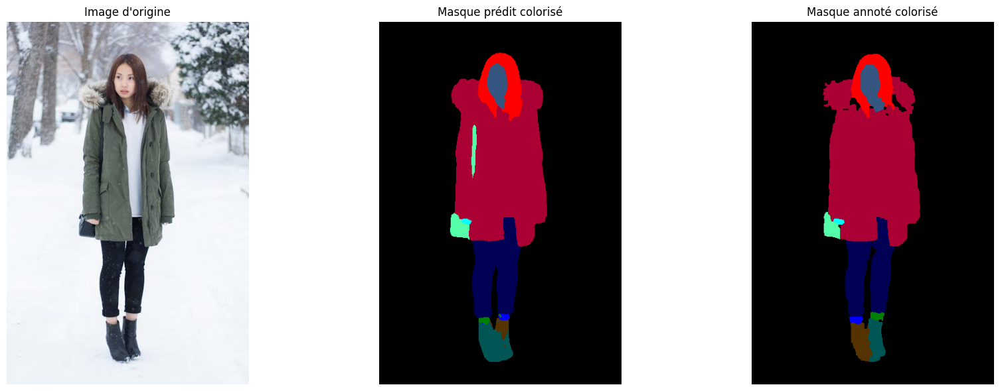

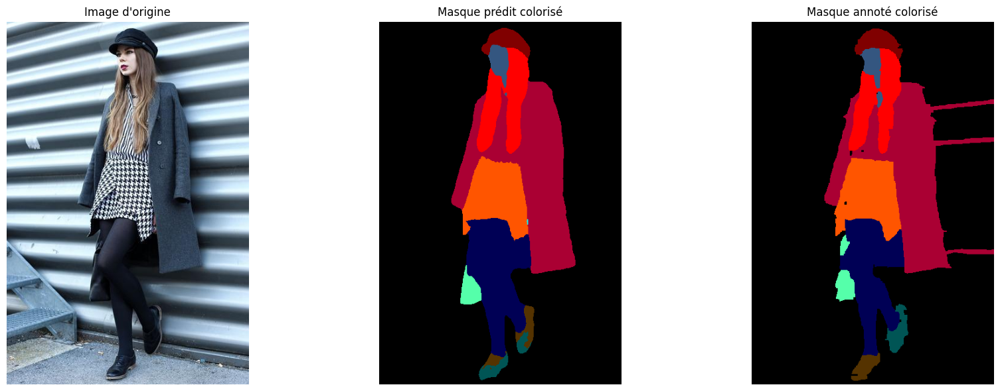

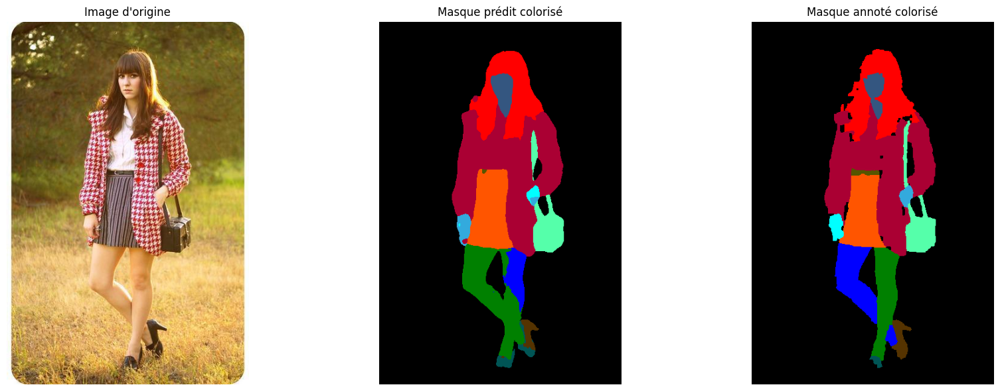

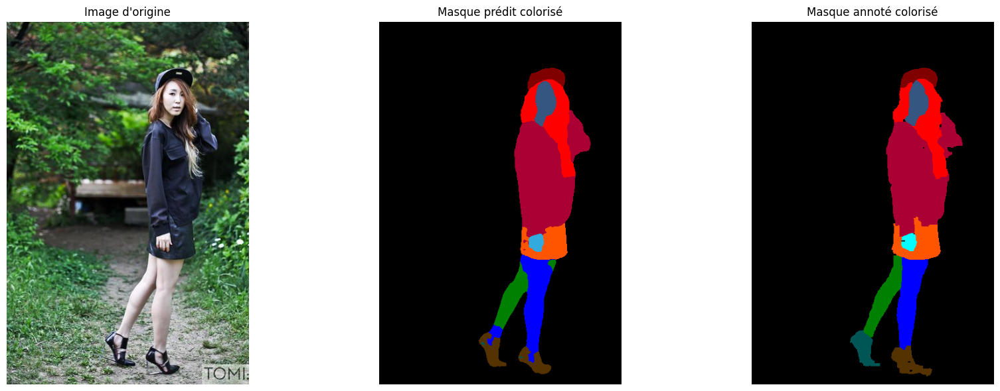

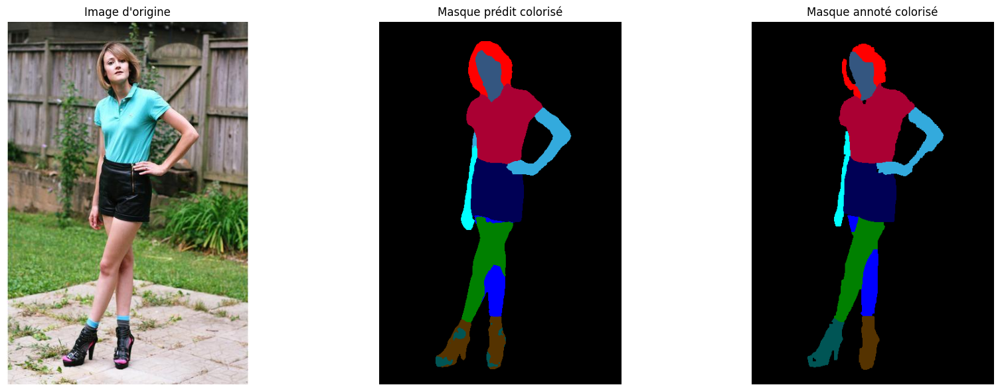

...

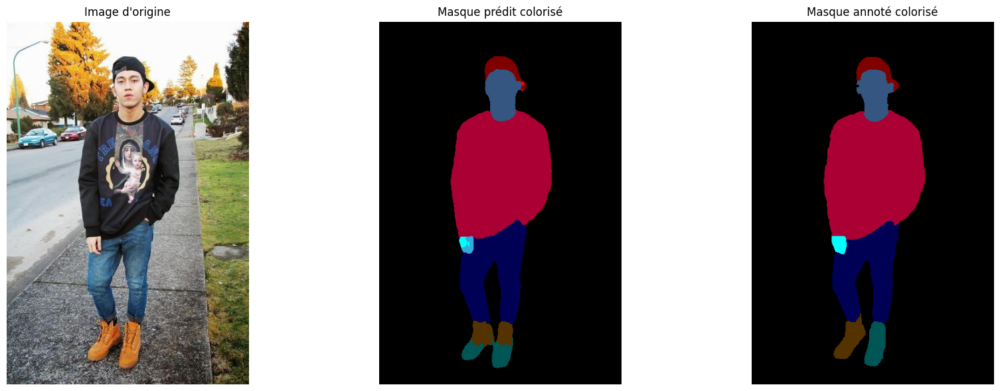

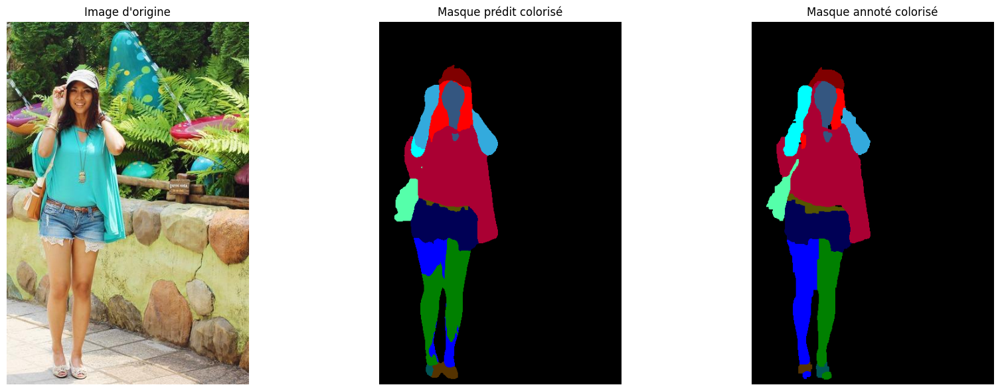

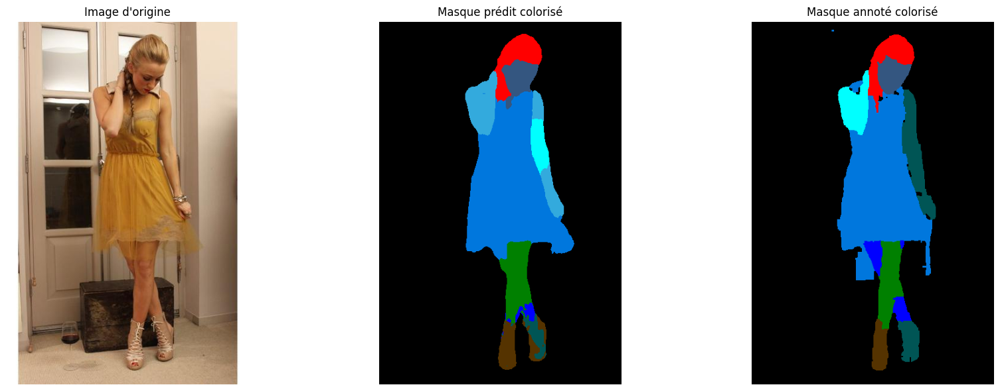

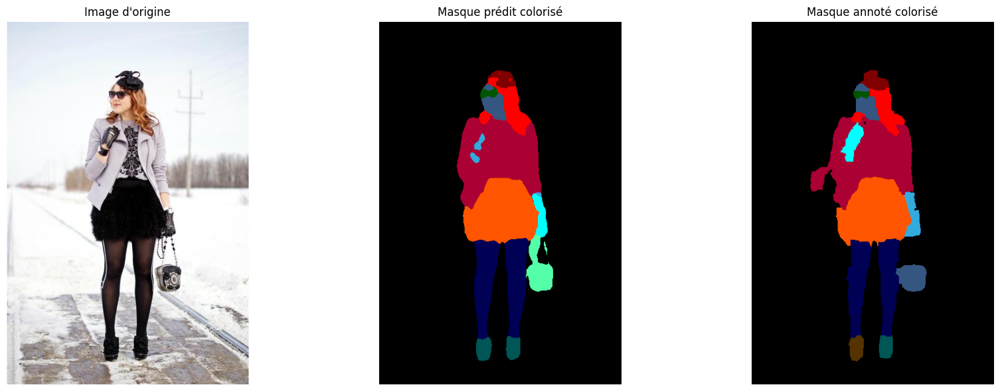

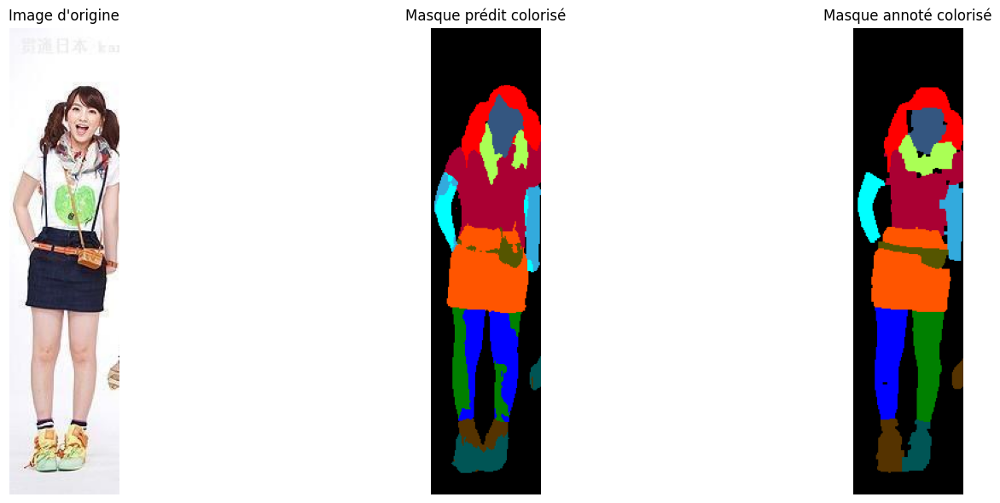

In [1]:
import sys
from pathlib import Path
import requests
import time
from io import BytesIO
import base64
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# --- Ajouter src/ au PYTHONPATH pour importer utils.py ---
src_path = (Path.cwd().parent / 'src').resolve()
if str(src_path) not in sys.path:
    sys.path.append(str(src_path))

from fashion_trend_intelligence.utils import HF_TOKEN

# --- Définition des dossiers ---
img_dir = Path('..') / 'data' / 'raw' / 'images'
mask_annot_color_dir = Path('..') / 'data' / 'processed' / 'masks_colorized'
mask_pred_dir = Path('..') / 'data' / 'processed'
mask_pred_color_dir = mask_pred_dir / 'masks_colorized'
mask_pred_color_dir.mkdir(parents=True, exist_ok=True)

# Palette officielle SegFormer ATR
palette = [
    [0, 0, 0], [128, 0, 0], [255, 0, 0], [0, 85, 0], [170, 0, 51],
    [255, 85, 0], [0, 0, 85], [0, 119, 221], [85, 85, 0], [0, 85, 85],
    [85, 51, 0], [52, 86, 128], [0, 128, 0], [0, 0, 255],
    [51, 170, 221], [0, 255, 255], [85, 255, 170], [170, 255, 85]
]

label_to_index = {
    'Background': 0, 'Hat': 1, 'Hair': 2, 'Sunglasses': 3, 'Upper-clothes': 4,
    'Skirt': 5, 'Pants': 6, 'Dress': 7, 'Belt': 8, 'Left-shoe': 9,
    'Right-shoe': 10, 'Face': 11, 'Left-leg': 12, 'Right-leg': 13,
    'Left-arm': 14, 'Right-arm': 15, 'Bag': 16, 'Scarf': 17
}

def colorize_mask(mask):
    color_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)
    for label, color in enumerate(palette):
        color_mask[mask == label] = color
    return color_mask

def call_hf_api(image_bytes, token, max_retries=3, backoff=10):
    """
    Appelle l'API HF avec gestion explicite des timeouts et des limites de requête.
    Les erreurs 429 et timeout sont détectées, et la requête est retentée jusqu'à max_retries fois.
    Un message informatif est affiché à chaque erreur.
    """
    url = "https://api-inference.huggingface.co/models/sayeed99/segformer_b3_clothes"
    headers = {
        "Authorization": f"Bearer {token}",
        "Accept": "application/json",
        "Content-Type": "application/octet-stream"
    }
    for attempt in range(max_retries):
        try:
            # Timeout explicite (20s) pour ne pas bloquer indéfiniment.
            resp = requests.post(url, headers=headers, data=image_bytes, timeout=20)

            if resp.status_code == 429:
                # 429 = "Too Many Requests" (limite atteinte)
                print(f"⚠️ Limite de requêtes atteinte (HTTP 429), essai {attempt + 1}/{max_retries} :")
                print(f"   Pause de {backoff * (attempt + 1)}s avant retry.")
                time.sleep(backoff * (attempt + 1))
                continue

            resp.raise_for_status()  # Lève une exception si code HTTP >=400
            return resp.json()       # Succès, retourne la réponse JSON

        except requests.exceptions.Timeout:
            print(f"⏳ Timeout lors de l'appel API (tentative {attempt + 1}/{max_retries}), retry dans {backoff * (attempt + 1)}s.")
            time.sleep(backoff * (attempt + 1))
        except requests.exceptions.RequestException as e:
            print(f"❌ Erreur réseau/API (tentative {attempt + 1}/{max_retries}) : {e}")
            time.sleep(backoff * (attempt + 1))
    # Si toutes les tentatives échouent, on lève une erreur bloquante :
    raise RuntimeError("Échec : impossible d'obtenir une réponse de l'API HF (cf. logs ci-dessus).")

# --- Traitement de toutes les images ---
image_files = sorted(img_dir.glob('image_*.png'))
if not image_files:
    print("Aucune image trouvée dans le dossier images.")
else:
    for img_path in image_files:
        image_idx = img_path.stem.split('_')[-1]
        annot_color_path = mask_annot_color_dir / f"mask_{image_idx}_colorized.png"
        pred_mask_filename = f"pred_{image_idx}.png"
        pred_mask_color_filename = f"pred_{image_idx}_colorized.png"
        pred_mask_path = mask_pred_dir / pred_mask_filename
        pred_mask_color_path = mask_pred_color_dir / pred_mask_color_filename

        with open(img_path, 'rb') as f:
            img_bytes = f.read()

        try:
            # Appel API avec gestion des erreurs spécifiques
            result = call_hf_api(img_bytes, HF_TOKEN)

            if not isinstance(result, list):
                print(f"Réponse inattendue pour {img_path.name}: {result}")
                continue
            
            masks_by_class = {}
            height, width = None, None

            for mask_info in result:
                label = mask_info.get('label')
                idx = label_to_index.get(label)
                mask_b64 = mask_info.get('mask')
                if idx is not None and mask_b64:
                    mask_bytes = base64.b64decode(mask_b64)
                    mask_img = Image.open(BytesIO(mask_bytes)).convert("L")
                    mask_np = np.array(mask_img)
                    if height is None or width is None:
                        height, width = mask_np.shape
                    masks_by_class[idx] = mask_np

            mask_indices = np.zeros((height, width), dtype=np.uint8)
            for class_id, mask_np in masks_by_class.items():
                mask_indices[mask_np > 127] = class_id

            # Sauvegarde du masque en niveaux de gris (par classe)
            Image.fromarray(mask_indices).save(pred_mask_path)

            # Colorisation et sauvegarde du masque colorisé
            mask_pred_color = colorize_mask(mask_indices)
            Image.fromarray(mask_pred_color).save(pred_mask_color_path)

            # VISUALISATION : triplet image brute | prédiction | annotation
            fig, axs = plt.subplots(1, 3, figsize=(18, 6))
            axs[0].imshow(Image.open(img_path))
            axs[0].set_title("Image d'origine")
            axs[0].axis('off')
            axs[1].imshow(mask_pred_color)
            axs[1].set_title("Masque prédit colorisé")
            axs[1].axis('off')
            if annot_color_path.exists():
                axs[2].imshow(Image.open(annot_color_path))
                axs[2].set_title("Masque annoté colorisé")
            else:
                axs[2].text(0.5, 0.5, "Manquant", fontsize=14, ha='center')
                axs[2].set_title("Masque annoté colorisé")
            axs[2].axis('off')
            plt.tight_layout()
            plt.show()

        except RuntimeError as e:
            print(f"⛔ Erreur bloquante sur {img_path.name} : {e}")
        except Exception as e:
            print(f"❌ Erreur inattendue lors du traitement de {img_path.name} : {e}")

## 🚧 Difficultés rencontrées lors du projet Segmentation Vestimentaire

### 1. Gestion du token Hugging Face et importation dans le notebook

Lors de l’adaptation de mon fichier `utils.py` pour le rendre compatible avec une utilisation sur Google Colab, l’import du token Hugging Face ne fonctionnait plus. Je ne m’en suis pas tout de suite aperçu, car la variable d’environnement était déjà chargée dans mon notebook de test, ce qui masquait le dysfonctionnement. Sur un nouveau notebook, l’import échouait effectivement. Pour éviter ces soucis, je suis simplement revenu à une version antérieure et plus stable de `utils.py`.

---

### 2. Accès à l’API Hugging Face : documentation et URL

J’avais d’abord suivi les indications fournies par ChatGPT pour interroger l’API du modèle, mais après plusieurs échecs frustrants, je suis allé consulter directement la page du projet. J’y ai trouvé la bonne méthode ainsi que l’URL adéquate pour faire fonctionner les requêtes.

---

### 3. Décodage et interprétation des résultats API

Je m’attendais à ce que l’API me renvoie directement une image de segmentation finale. En réalité, la réponse de l’API contient, pour chaque classe (par exemple “pantalon”, “sac”, “cheveux”…), un masque binaire : c’est-à-dire une matrice indiquant, pour chaque pixel de l’image, si la classe est présente (`1`) ou absente (`0`).  
Pour reconstituer le masque de segmentation global (où chaque pixel porte un numéro de classe), il faut “compiler” tous ces masques binaires : pour chaque pixel, on attribue le numéro de la classe correspondante si ce pixel est activé dans le masque de la classe. On obtient ainsi, à la fin, une image d’indices utilisable pour la colorisation, la visualisation ou la comparaison avec l’annotation.

#### Le code Python initial (qui ne fonctionnait pas) :
<code>
    result = call_hf_api(img_bytes, HF_TOKEN)
    mask_b64 = result['segmentation']
    mask_bytes = base64.b64decode(mask_b64)
    mask_pred_img = Image.open(BytesIO(mask_bytes)).convert('L')
</code>
Ce code supposait que la clé `'segmentation'` était directement accessible dans la réponse, ce qui n’était pas le cas.

#### Le code Python corrigé pour exploiter le format réel de la réponse :
<code>
    result = call_hf_api(img_bytes, HF_TOKEN)
    masks_by_class = {}
    height, width = None, None
    
    for mask_info in result:
    label = mask_info.get('label')
    idx = label_to_index.get(label)
    mask_b64 = mask_info.get('mask')
    if idx is not None and mask_b64:
    mask_bytes = base64.b64decode(mask_b64)
    mask_img = Image.open(BytesIO(mask_bytes)).convert("L")
    mask_np = np.array(mask_img)
    if height is None or width is None:
    height, width = mask_np.shape
    masks_by_class[idx] = mask_np
    
    mask_indices = np.zeros((height, width), dtype=np.uint8)
    for class_id, mask_np in masks_by_class.items():
    mask_indices[mask_np > 127] = class_id
</code>
... puis colorisation, sauvegarde, affichage comme avant

---

### 4. Limite de quotas

Les quotas de l’API Hugging Face limitent le nombre d’images que l’on peut traiter à la suite : il faut donc parfois patienter ou étaler les requêtes pour ne pas saturer le service.

---

### 5. Qualité de la segmentation : comparaison visuelle

En comparant mes masques de prédiction avec les masques annotés, j’ai constaté que dans quelques rares cas le modèle prédisait plus finement certains détails (par exemple, la lanière d’un sac bien détectée alors qu’elle manque dans l’annotation). Mais dans la majorité des situations, on observe de nombreuses erreurs : inversions entre gauche et droite, confusions entre des parties distinctes (fusion), ou encore la présence d’artefacts qui ne devraient pas exister.

---

## Conclusion

Ces difficultés m'ont permis d'approfondir ma compréhension de la logique d’inférence, de la gestion des tokens et du fonctionnement réel des sorties API en segmentation. J’ai dû à plusieurs reprises revoir et renforcer la robustesse de ma chaîne d’intégration, et j’en ressors avec une meilleure maîtrise des conventions de nommage, des secrets, et des limites des outils cloud pour l’IA appliquée.
